# **1. Xây dựng mạng một kiến trúc mạng CNN để phân loại bệnh nhân bị viêm phổi hay không bị viêm phổi dựa trên ảnh X-Ray.**

Import các thư viện

In [1]:
import os
import cv2
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import glob
import seaborn as sn
import tensorflow
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Dropout, Flatten, Input, Reshape
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Conv2D, MaxPooling2D
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import load_model
from keras.models import Sequential
import sklearn.metrics
from sklearn.metrics import accuracy_score
import seaborn as sn
from sklearn.metrics import classification_report
from tensorflow.keras.applications import ResNet50V2
from sklearn.utils import shuffle

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


Chia 2 thư mục train và test

In [2]:
train_dir = '/kaggle/input/chest-xray-pneumonia/chest_xray/train'
test_dir = '/kaggle/input/chest-xray-pneumonia/chest_xray/test'
categories = ["NORMAL", "PNEUMONIA"]
img_size = 128

In [3]:
X_train_label = []
X_train_list = []
X_test_label = []
X_test_list = []

Load data và preprocessing

Train set

In [4]:
normal_train_list = glob.glob(train_dir+"/"+categories[0]+"/*")
pneumonia_train_list = glob.glob(train_dir+"/"+categories[1]+"/*")
for name in normal_train_list:
    X_train_label.append(0)
    img = cv2.imread(name)
#     img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    img = tensorflow.keras.preprocessing.image.img_to_array(img)
    img = cv2.resize(img,(img_size,img_size), interpolation=cv2.INTER_AREA)
    X_train_list.append((img))
for name in pneumonia_train_list:
    X_train_label.append(1)
    img = cv2.imread(name)
#     img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    img = tensorflow.keras.preprocessing.image.img_to_array(img)
    img = cv2.resize(img,(img_size,img_size), interpolation=cv2.INTER_AREA)
    X_train_list.append((img))

Test set

In [5]:
normal_test_list = glob.glob(test_dir+"/"+categories[0]+"/*")
pneumonia_test_list = glob.glob(test_dir+"/"+categories[1]+"/*")
for name in normal_test_list:
    X_test_label.append(0)
    img = cv2.imread(name)
#     img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    img = tensorflow.keras.preprocessing.image.img_to_array(img)
    img = cv2.resize(img,(img_size,img_size), interpolation=cv2.INTER_AREA)
    X_test_list.append((img))
for name in pneumonia_test_list:
    X_test_label.append(1)
    img = cv2.imread(name)
#     img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    img = tensorflow.keras.preprocessing.image.img_to_array(img)
    img = cv2.resize(img,(img_size,img_size), interpolation=cv2.INTER_AREA)
    X_test_list.append((img))

In [6]:
X_train = np.array(X_train_list, dtype = 'float32')
y_train = np.array(X_train_label, dtype = 'int32').reshape(-1,1)
X_test = np.array(X_test_list, dtype = 'float32')
y_test = np.array(X_test_label, dtype = 'int32').reshape(-1,1)
print(y_train.shape)
print(y_test.shape)

(5216, 1)
(624, 1)


Chuẩn hoá input, output

In [7]:
X_train_scaled = np.array(X_train)/255.
X_test_scaled = np.array(X_test)/255.
print(X_train_scaled.shape, X_test_scaled.shape)

(5216, 128, 128, 3) (624, 128, 128, 3)


Chia tập train thành tập train và tập validation

In [8]:
X_train_scaled, y_train = shuffle(X_train_scaled, y_train, random_state=42)
X_train_scaled, X_val_scaled,y_train, y_val = train_test_split(X_train_scaled, y_train, test_size=0.3)

In [9]:
print(X_train_scaled.shape)
print(X_val_scaled.shape)
print(X_test_scaled.shape)

(3651, 128, 128, 3)
(1565, 128, 128, 3)
(624, 128, 128, 3)


Xây dựng mô hình CNN

In [10]:
inp = Input(shape = (128,128,3))
cnn = Conv2D(filters = 32 , kernel_size = 3 ,activation ='relu')(inp)
cnn = BatchNormalization()(cnn)
pooling = MaxPooling2D(pool_size=(2,2))(cnn)
drop = Dropout(0.2)(pooling)

cnn = Conv2D(filters = 64, kernel_size = 3, activation='relu')(drop)
cnn = BatchNormalization()(cnn)
pooling = MaxPooling2D(pool_size = (2,2))(cnn)
drop = Dropout(0.2)(pooling)

cnn = Conv2D(filters = 128, kernel_size = 3, activation='relu')(drop)
cnn = BatchNormalization()(cnn)
pooling = MaxPooling2D(pool_size = (2,2))(cnn)
drop = Dropout(0.2)(pooling)

f = Flatten()(drop)

fc1 = Dense(units = 256, activation ='relu')(f)
fc2  = Dense(units = 16,activation = 'relu')(fc1)
out = Dense(units=1,activation='sigmoid')(fc2)

model = Model(inputs = inp, outputs =out)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 128, 128, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 126, 126, 32)      896       
                                                                 
 batch_normalization (Batch  (None, 126, 126, 32)      128       
 Normalization)                                                  
                                                                 
 max_pooling2d (MaxPooling2  (None, 63, 63, 32)        0         
 D)                                                              
                                                                 
 dropout (Dropout)           (None, 63, 63, 32)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 61, 61, 64)        18496 

Trực quan hoá mô hình

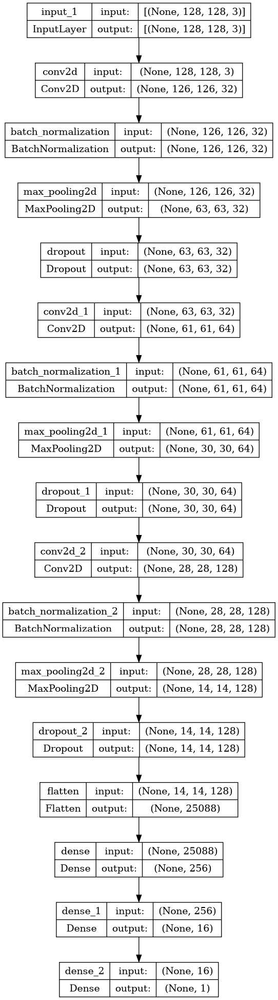

In [11]:
tensorflow.keras.utils.plot_model(model, show_layer_names=True, show_shapes=True)

Tối ưu hoá bằng Adam, huấn luyện mô hình

In [12]:
optimizer1 = tensorflow.keras.optimizers.Adam(learning_rate = 0.0001)
model.compile(optimizer = optimizer1, loss='binary_crossentropy',metrics = ['accuracy'])
history = model.fit(X_train_scaled,y_train,batch_size=64,
epochs = 20, validation_data = (X_val_scaled, y_val))

Epoch 1/20


2023-11-16 17:15:06.284333: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel/dropout/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


58/58 [==============================] - 13s 62ms/step - loss: 0.2172 - accuracy: 0.9134 - val_loss: 0.5558 - val_accuracy: 0.7380
Epoch 2/20
58/58 [==============================] - 2s 43ms/step - loss: 0.1018 - accuracy: 0.9584 - val_loss: 0.7905 - val_accuracy: 0.7380
Epoch 3/20
58/58 [==============================] - 2s 43ms/step - loss: 0.0816 - accuracy: 0.9721 - val_loss: 1.4548 - val_accuracy: 0.7380
Epoch 4/20
58/58 [==============================] - 2s 43ms/step - loss: 0.0702 - accuracy: 0.9734 - val_loss: 1.7522 - val_accuracy: 0.7380
Epoch 5/20
58/58 [==============================] - 2s 43ms/step - loss: 0.0610 - accuracy: 0.9767 - val_loss: 2.0145 - val_accuracy: 0.7380
Epoch 6/20
58/58 [==============================] - 2s 43ms/step - loss: 0.0503 - accuracy: 0.9789 - val_loss: 2.0202 - val_accuracy: 0.7380
Epoch 7/20
58/58 [==============================] - 2s 43ms/step - loss: 0.0401 - accuracy: 0.9844 - val_loss: 1.9315 - val_accuracy: 0.7387
Epoch 8/20
58/58 [=====

# **2. Vẽ biểu đồ thể hiện kết quả quá trình huấn luyện mô hình.**

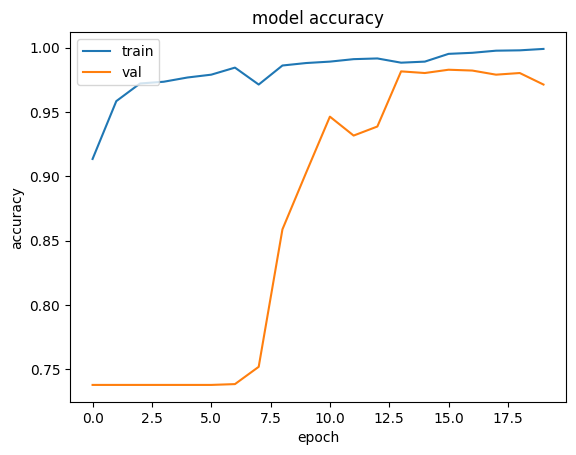

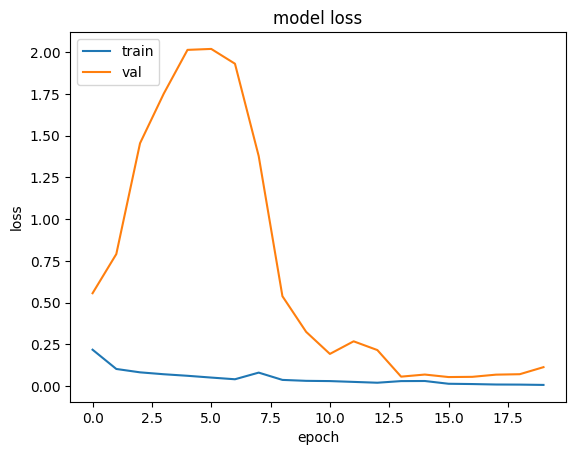

In [13]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train','val'],loc = 'upper left')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train','val'],loc='upper left')
plt.show()

Lưu mô hình, load mô hình đã lưu từ máy

In [14]:
model.save('model1.h5')

/opt/conda/lib/python3.10/site-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [15]:
model1 = load_model('/kaggle/working/model1.h5')

Tính y dự đoán từ mô hình đã lưu

In [16]:
y_hat = model1.predict(X_test_scaled)

20/20 [==============================] - 0s 8ms/step


Threshold binary của y dự đoán

In [17]:
def predict(y_hat):
    y_hat[y_hat >= 0.5] =1
    y_hat[y_hat < 0.5] =0
    return y_hat
y_pred = predict(y_hat)

# **3. Đánh giá kết quả của mô hình thu được.**

Precision, recall, F1-score

In [18]:
target_names = ['NORMAL', 'PNEUMONIA']
print(classification_report(y_test, y_pred,target_names=target_names))

              precision    recall  f1-score   support

      NORMAL       0.99      0.33      0.50       234
   PNEUMONIA       0.71      1.00      0.83       390

    accuracy                           0.75       624
   macro avg       0.85      0.67      0.67       624
weighted avg       0.82      0.75      0.71       624



Accuracy

In [19]:
accuracy = accuracy_score(y_test, y_pred)
print('Accuracy:', accuracy)

Accuracy: 0.7483974358974359


Confusion matrix

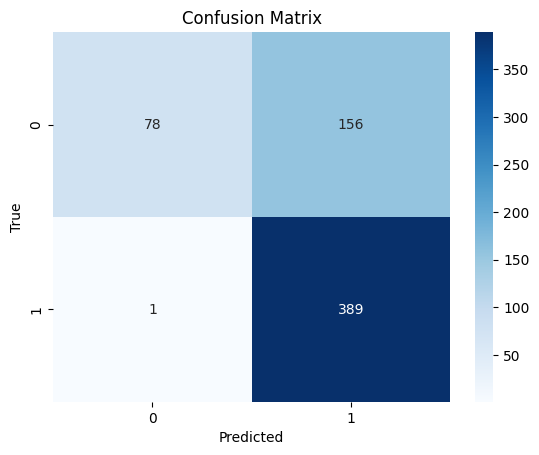

In [20]:
# Tạo confusion matrix
cm = sklearn.metrics.confusion_matrix(y_test, y_pred)

# Vẽ confusion matrix
plt.figure()
sn.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

# **4. Tìm hiểu một mạng kiến trúc mạng Pre-train model để giải quyết bài toán này (Ví dụ: ResNet50).**

Chuẩn bị input, output

In [21]:
X_train = np.array(X_train_list, dtype = 'float32')
y_train = np.array(X_train_label, dtype = 'int32').reshape(-1,1)
X_test = np.array(X_test_list, dtype = 'float32')
y_test1 = np.array(X_test_label, dtype = 'int32').reshape(-1,1)

X_train_scaled1 = np.array(X_train)/255.
X_test_scaled1 = np.array(X_test)/255.

X_train_scaled1, y_train = shuffle(X_train_scaled1, y_train, random_state=42)
X_train_scaled1, X_val_scaled1, y_train, y_val = train_test_split(X_train_scaled1, y_train, test_size=0.3)

Kiến trúc của mạng ResNet50:

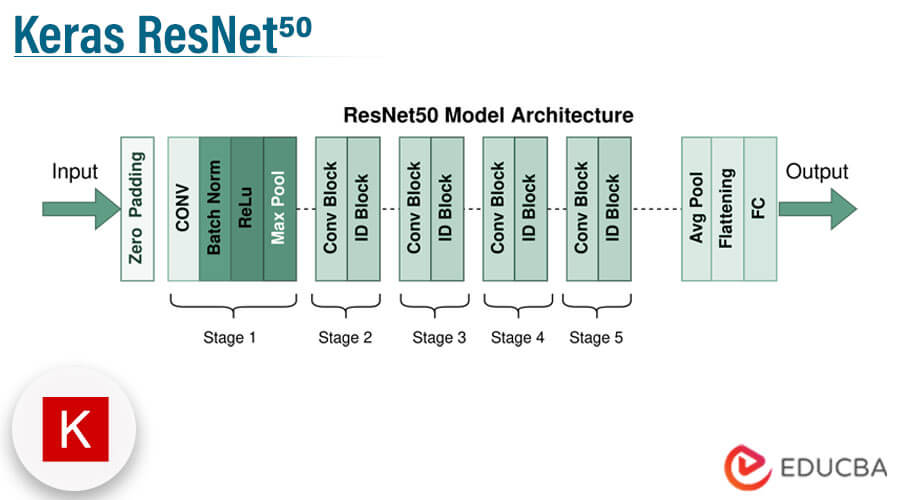

Kết nối ResNet50

In [22]:
resnet50 = ResNet50V2(weights = "imagenet", input_shape = (128,128,3), include_top = False)

94668760/94668760 [==============================] - 6s 0us/step


Xây dựng mô hình với ResNet50

In [23]:
model = Sequential()

model.add(resnet50)

for layer in resnet50.layers:
    layer.trainable = False

model.add(Flatten())

model.add(Dense(units = 128, activation = "relu"))
model.add(Dense(units = 16, activation = "relu"))
model.add(Dropout(0.5))

model.add(Dense(units = 1, activation = "sigmoid"))

Tối ưu hoá bằng Adam

In [24]:
optimizer1 = tensorflow.keras.optimizers.Adam(learning_rate = 0.005)
model.compile(optimizer = optimizer1, loss = "binary_crossentropy", metrics = ["accuracy"])
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50v2 (Functional)     (None, 4, 4, 2048)        23564800  
                                                                 
 flatten_1 (Flatten)         (None, 32768)             0         
                                                                 
 dense_3 (Dense)             (None, 128)               4194432   
                                                                 
 dense_4 (Dense)             (None, 16)                2064      
                                                                 
 dropout_3 (Dropout)         (None, 16)                0         
                                                                 
 dense_5 (Dense)             (None, 1)                 17        
                                                                 
Total params: 27761313 (105.90 MB)
Trainable params: 419

Trực quan hoá mô hình pre-train

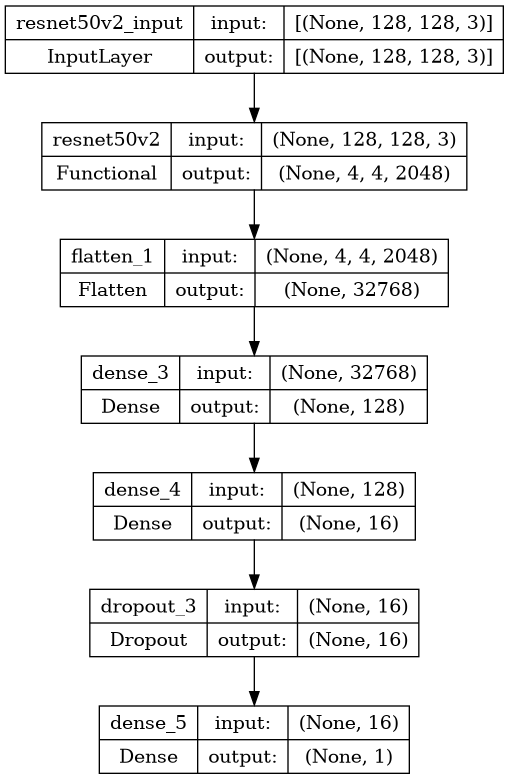

In [25]:
tensorflow.keras.utils.plot_model(model, show_layer_names=True, show_shapes=True)

Huấn luyện mô hình

In [26]:
history = model.fit(X_train_scaled1,y_train,batch_size=64,
epochs = 20, validation_data = (X_val_scaled1, y_val))

Epoch 1/20
58/58 [==============================] - 11s 102ms/step - loss: 0.8561 - accuracy: 0.7612 - val_loss: 0.3230 - val_accuracy: 0.7661
Epoch 2/20
58/58 [==============================] - 3s 59ms/step - loss: 0.4478 - accuracy: 0.7551 - val_loss: 0.3085 - val_accuracy: 0.7450
Epoch 3/20
58/58 [==============================] - 3s 59ms/step - loss: 0.3675 - accuracy: 0.7420 - val_loss: 0.2539 - val_accuracy: 0.7450
Epoch 4/20
58/58 [==============================] - 3s 59ms/step - loss: 0.3541 - accuracy: 0.7464 - val_loss: 0.2293 - val_accuracy: 0.9565
Epoch 5/20
58/58 [==============================] - 3s 59ms/step - loss: 0.3464 - accuracy: 0.7787 - val_loss: 0.2576 - val_accuracy: 0.9425
Epoch 6/20
58/58 [==============================] - 3s 59ms/step - loss: 0.3569 - accuracy: 0.7631 - val_loss: 0.2378 - val_accuracy: 0.9444
Epoch 7/20
58/58 [==============================] - 3s 59ms/step - loss: 0.3534 - accuracy: 0.7675 - val_loss: 0.2588 - val_accuracy: 0.9610
Epoch 8/20


Vẽ đồ thị accuracy và loss vừa train

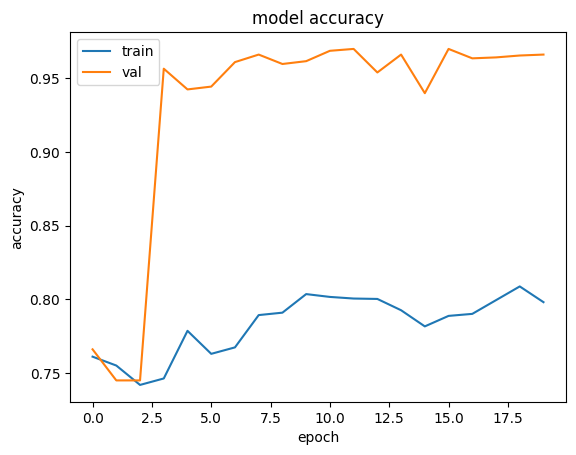

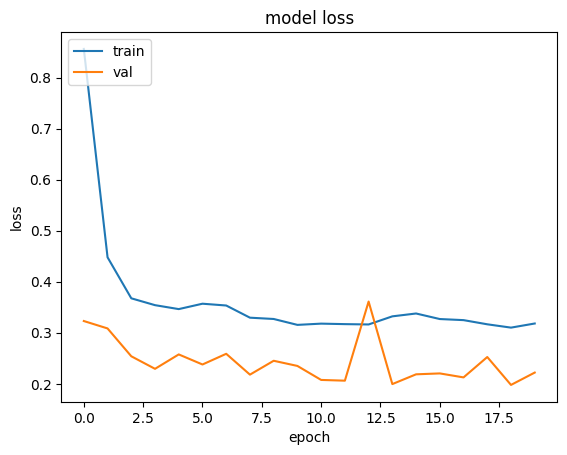

In [27]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train','val'],loc = 'upper left')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train','val'],loc='upper left')
plt.show()

Lưu mô hình, load mô hình ResNet50 vừa train

In [28]:
model.save('model2.h5')
model2 = load_model('/kaggle/working/model2.h5')

/opt/conda/lib/python3.10/site-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Tính y dự đoán từ mô hình đã lưu

In [29]:
y_hat = model2.predict(X_test_scaled1)

20/20 [==============================] - 2s 46ms/step


Threshold binary y dự đoán

In [30]:
def predict(y_hat):
    y_hat[y_hat >= 0.5] =1
    y_hat[y_hat < 0.5] =0
    return y_hat
y_pred1 = predict(y_hat)

## Đánh giá mô hình pre-train

Precision. recall, F1-score

In [31]:
from sklearn.metrics import classification_report
target_names = ['NORMAL', 'PNEUMONIA']
print(classification_report(y_test1, y_pred1,target_names=target_names))

              precision    recall  f1-score   support

      NORMAL       0.94      0.53      0.68       234
   PNEUMONIA       0.78      0.98      0.87       390

    accuracy                           0.81       624
   macro avg       0.86      0.75      0.77       624
weighted avg       0.84      0.81      0.80       624



Accuracy

In [32]:
from sklearn.metrics import accuracy_score
accuracy1 = accuracy_score(y_test1, y_pred1)
print('Accuracy:', accuracy1)

Accuracy: 0.8108974358974359


Confusion matrix

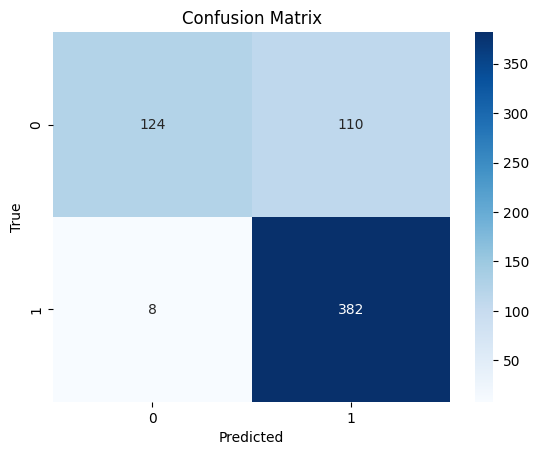

In [33]:
import sklearn.metrics
import seaborn as sn

# Tạo confusion matrix
cm = sklearn.metrics.confusion_matrix(y_test1, y_pred1)

# Vẽ confusion matrix
plt.figure()
sn.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

## So sánh độ chính xác của 2 mô hình

In [34]:
print('Accuracy của mô hình CNN tự xây dựng: ', accuracy)
print('Accuracy của mô hình pre-train ResNet50: ', accuracy1)

Accuracy của mô hình CNN tự xây dựng:  0.7483974358974359
Accuracy của mô hình pre-train ResNet50:  0.8108974358974359


# **5. So sánh kết quả thu được của 2 mô hình (1 & 4).**

Kết quả của mô hình 1

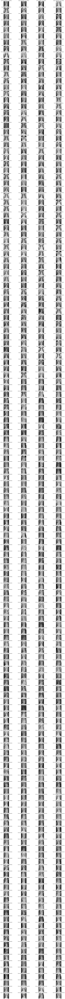

In [35]:
# Check with some set
plt.figure(figsize=(20,300))
for i in range(len(X_test_scaled)):
    plt.subplot(int(len(X_test_scaled)/4)+1,4,i+1)
    plt.title(f"Predict: {target_names[int(y_pred[i])]}, True: {target_names[int(y_test[i])]}", fontsize=10)
    plt.imshow(X_test_scaled[i])
    plt.axis("off")
plt.show()

Kết quả của mô hình 4

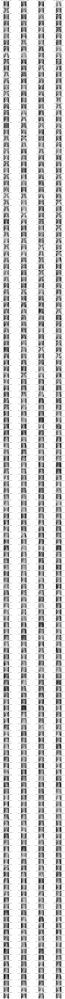

In [36]:
# Check with some set
plt.figure(figsize=(20,300))
for i in range(len(X_test_scaled1)):
    plt.subplot(int(len(X_test_scaled1)/4)+1,4,i+1)
    plt.title(f"Predict: {target_names[int(y_pred1[i])]}, True: {target_names[int(y_test1[i])]}", fontsize=10)
    plt.imshow(X_test_scaled1[i])
    plt.axis("off")
plt.show()